# Analysis for partial dataset using Numpy and Pandas

### Setting everything up

In [1]:
import os
#import iris
import numpy as np
import xarray as xr
import pandas as pd
import seaborn as sns
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import dask.array as da
import dask.dataframe as ddf

In [2]:
data_xr = xr.open_dataset('/project2/geos39650/jet_stream/data/df_lat_20_1D.nc')
# data_xr = xr.open_dataset('/scratch/midway2/afarah/jetstream/df_lat_20_1D.nc')
selected_dates= pd.date_range('1980-12-01',periods=12*7-1,freq='D').union(pd.date_range('1981-12-01',periods=12*7-1,freq='D'))#.union(pd.date_range(end='2018-02-28',periods=12*7-1,freq='D'))
data_xr=data_xr.sel(time=selected_dates)
data_xr

<xarray.Dataset>
Dimensions:    (latitude: 280, longitude: 1440, time: 166)
Coordinates:
  * time       (time) datetime64[ns] 1980-12-01 1980-12-02 ... 1982-02-21
  * latitude   (latitude) float32 90.0 89.75 89.5 89.25 ... 20.75 20.5 20.25
  * longitude  (longitude) float32 0.0 0.25 0.5 0.75 ... 359.25 359.5 359.75
Data variables:
    t2m        (time, latitude, longitude) float32 ...

### Formatting

In [3]:
#logistical functions
def convert_angles(data):
    '''convert to radians because fuck degrees'''
    if data['latitude'][0] >80: #just to make sure i dont do the multiplication twice
        data['latitude'] *= np.pi/180
        data['longitude'] *= np.pi/180
    return data

def prob_plots(binedges,pdf,ylab,cdf=None):
    if cdf is not None:
        plt.plot(binedges,cdf,label='cdf')
    plt.plot(binedges,pdf,label='pdf')
    plt.xlabel('bin edges [temp]')
    plt.ylabel(ylab)
    plt.legend()
    plt.show()
    
def globe_plots(xarr,titlestr="",contour=False,contours=None,savetitle=None):
    #set up the axes for a globe
    plt.subplots(figsize = (10, 10))
    ax = plt.axes(projection=ccrs.Orthographic(20, 90))
    #coolcool now we can plot it
    
    if contour:
        if contours is None:
            contours=range(int(xarr.min()),int(xarr.max()),10)
        xarr.plot.contourf(ax=ax,
                           transform=ccrs.PlateCarree(),
                           levels=contours,
                           center=0,
                           cbar_kwargs={'orientation': 'horizontal',
                                    'pad': 0.05,
                                    'shrink': 0.5,
                                    'ticks':contours}
                                       )
    else:
        xarr.plot(ax=ax, transform=ccrs.PlateCarree())
        
    ax.set_title(titlestr)
    #make it draw the pretty continents
    ax.set_global(); ax.coastlines();
    #draw lat-lon isocontours
    ax.gridlines()
    ax.plot()
    if savetitle is None:
        plt.show()
    else:
        plt.savefig('./figs/'+savetitle+'.png')
    
def convert_to_xarray(sequence,plot=False,contour=False, contours=None, 
                      titlestr=r"$T'(\phi,\lambda) =  T(\phi,\lambda) - T_{ref}(\phi) $", savetitle = None,
                      numweeks=1
                     ):
    """this assumes a very specific structure to the sequence 
    (0.25 deg resolution on regular grid, latitudes only above 20 deg)
    that probably only works for the specific data array I am using in this notebook.
    Note that if numweeks !=1, plotting probably won't work as planned.
    """
    #hard code my coords because I'm only going to use this
    latitude_coords = np.flip(np.arange(20.25,90.001,step=0.25))
    longitude_coords = np.arange(0,360,step=0.25)
    if numweeks == 1:
        d = ('lat','lon')
        c = {'lat':latitude_coords,'lon':longitude_coords}
        z = np.array(sequence).reshape((280,1440))
        print('one week!')
    else:
        d = ('time','lat','lon')
        time_coords = range(numweeks)
        c = {'time': time_coords,'lat':latitude_coords,'lon':longitude_coords}
        z = np.array(sequence).reshape((numweeks,280,1440))
    xarr = xr.DataArray(z,
                       dims = d,
                       coords = c)
    if plot:
        globe_plots(xarr,titlestr,contour=contour,contours=contours,savetitle=savetitle)
    
    return xarr

In [4]:
#set logistical global vars
R_earth = 6367.47 #km
dphi = 0.25*np.pi/180. #radians, this is also dlambda

#make temperature bins
# Tmin = data_xr.t2m.min()
# Tmax = data_xr.t2m.max() #kelvin
# Tbins = range(int(Tmin),int(Tmax),5)

num_time_intervals = len(data_xr.time)

# weeks = range(len(data_df['time'].unique())) #should be 14 weeks, but just in case, this makes it flexible
times = data_xr.time.values
convert_angles(data_xr)
data_df=data_xr.to_dataframe()
data_df.reset_index(drop=False,inplace=True)

### create mock data for when my permissions suck

In [22]:
selected_dates = pd.date_range('1980-12-01',periods=12*7-1,freq='D').union(pd.date_range(end='2018-02-28',periods=12*7-1,freq='D'))
latitude_coords = np.flip(np.arange(20.25,90.001,step=0.25))
longitude_coords = np.arange(0,360,step=0.25)
d = ('latitude','longitude','time')
c = {'latitude':latitude_coords,'longitude':longitude_coords,'time':selected_dates}
mock_temp = np.random.uniform(low=260,high=350,size=280*1440*len(selected_dates)).reshape((280,1440,len(selected_dates)))
xarr = xr.DataArray(mock_temp, dims = d, coords = c)

#groom mock data
num_time_intervals = len(xarr.time)
convert_angles(xarr)
data_df=xarr.to_dataframe(name='t2m')
data_df.reset_index(drop=False,inplace=True)

#temperature bins
Tmin = data_df.t2m.min()
Tmax = data_df.t2m.max() #kelvin
Tbins = range(int(Tmin),int(Tmax),5)

## Actually start analyzing 

In [5]:
#analysis functions
def dists_of_boxes(temp_df,plot=False):
    #number of boxes at each temp
    pdf_boxes, binedges = np.histogram(temp_df,bins=Tbins)
    #number of boxes below each temp
    cdf_boxes=np.cumsum(pdf_boxes)
    if plot:
        prob_plots(binedges[:-1],pdf_boxes,'number of boxes',cdf=cdf_boxes)
    return binedges[:-1], pdf_boxes, cdf_boxes

#area 
def dists_of_areas(df,plot=False):
    #weight entry by box area so that y axis is no longer the number of boxes, but rather the area taken up by each box
    #this is the area of each grid cell
    
    temp = df.t2m
    areas = (R_earth*dphi)**2 * np.cos(df.latitude)    
    
    Tmin = temp.min()
    Tmax = temp.max() #kelvin
    Tbins = range(int(Tmin),int(Tmax),5)
    pdf_areas, binedges = np.histogram(temp,bins=Tbins,weights=areas) 
    
    pdf_areas *=1./num_time_intervals
    cdf_areas=np.cumsum(pdf_areas)
    if plot:
        prob_plots(binedges[:-1],pdf_areas,'area [km^2]',cdf=cdf_areas)

    return binedges[:-1], cdf_areas

#convert area to effective latitude
def dists_of_lat_eff(cdf_areas,binedges=None,plot=False):
    """if plot is set to true, must specify binedges"""
    #A = 2piR^2 (1-sin(lat_eff))
    #so 1-A/(2piR^2) = sin(lat_eff)
    #but remember latitude is defined to start at pi/2 at the north pole
    pdf_lat_effs = np.pi/2.-np.arccos(1-cdf_areas / (2*np.pi*R_earth**2) )
    if plot:
        prob_plots(binedges,pdf_lat_effs*180/np.pi,'effective lat')
    return pdf_lat_effs

#use maps on real data
def T_ref(true_lat,temp_binedges,pdf_lat_effs):
    """take a lat point and calculate T_ref with just the latitude, given the effective lat vs temp contour relation"""
    T_ref = np.interp(true_lat,np.flip(pdf_lat_effs),np.flip(temp_binedges))
    return T_ref #just a func of latitude
    
def T_prime(df,temp_binedges,pdf_lat_effs):
    #note that the below will assign a tref column to the global dataframe
    df['t_ref'] = T_ref(df['latitude'],temp_binedges,pdf_lat_effs)
    
    #calculate T'(lat,lon) which is T_true(lat,lon,time) - T_ref(lat,lon,time)
    df['t_prime'] =  df.t2m - df['t_ref'] #this is a function of longitude and time
    return df['t_prime'] 

def true_T_to_lat_eff(df,temp_binedges,pdf_lat_effs):
    temps = df.t2m
    lat_eff = np.interp(temps,temp_binedges,pdf_lat_effs)
    print('interpolated lat eff')
    df['lat_eff'] =  lat_eff
    return df['lat_eff']

def de_mean(df,key,replace=False):
    '''take the means along the date, lat, and lon dimensions and subtract them from the appropriate points.
    Then, replace the original with the de-meaned value'''
    tiny_groups = df.groupby(by=[df.time.dt.dayofyear,'latitude','longitude'])[key].mean() #as_index=False

    tiny_groups.rename_axis(index={'time':'doy'},inplace=True)
    meaned_df = tiny_groups.reset_index(drop=False)
    df['doy'] = df.time.dt.dayofyear 
    
    merged_df = df.merge(meaned_df,left_on=['doy','latitude','longitude'],right_on=['doy','latitude','longitude'],
                  how='left',suffixes=('_original','_mean'))

    if replace:
        df[key] = merged_df[key+'_original'] - merged_df[key+'_mean'] 
    elif not replace:
        df[key+'_demeaned'] = merged_df[key+'_original'] - merged_df[key+'_mean'] 


def run_them_all(df,de_mean_before=False,de_mean_after=False,pl=False):
    if de_mean_before:
        de_mean(df,'t2m',replace=True)
#     time_groups = df.groupby(by=[df.time.dt.week])
    binedgs,cdf_area = dists_of_areas(df,plot=pl)
    pdf_lat_effs = dists_of_lat_eff(cdf_area,binedges=binedgs,plot=pl)
    Tprime = T_prime(df,binedgs,pdf_lat_effs)
    lat_eff = true_T_to_lat_eff(df,binedgs,pdf_lat_effs)
    df['phi_prime'] = df.latitude - df.lat_eff
    if de_mean_after:
        de_mean(df,'lat_eff',replace=False)
        de_mean(df,'t_prime',replace=False)
        return binedgs, pdf_lat_effs

#### de-mean at temperature level

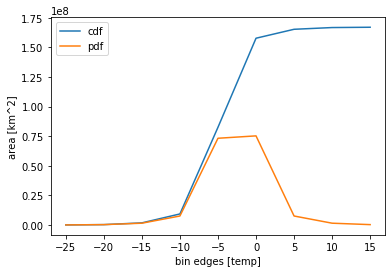

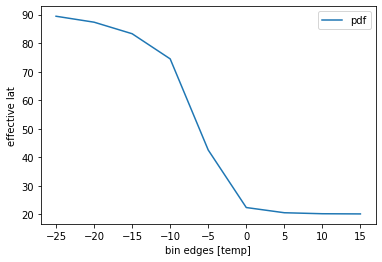

interpolated lat eff


In [6]:
#reset dataframe values so that nothing is de-meaned and all the columns are the original, from the raw data
data_df=data_xr.to_dataframe()
data_df.reset_index(drop=False,inplace=True)
run_them_all(data_df,de_mean_before=True,pl=True)

In [18]:
data_df

,latitude,longitude,time,t2m,doy,t_ref,t_prime,lat_eff,phi_prime
0,1.570796,0.000000,1980-12-01,-4.288223,336,209.0,-213.288223,1.570796,4.371139e-08
1,1.570796,0.000000,1980-12-02,-2.177170,337,209.0,-211.177170,1.570796,4.371139e-08
2,1.570796,0.000000,1980-12-03,-1.291122,338,209.0,-210.291122,1.570796,4.371139e-08
3,1.570796,0.000000,1980-12-04,3.119339,339,209.0,-205.880661,1.570796,4.371139e-08
4,1.570796,0.000000,1980-12-05,1.491287,340,209.0,-207.508713,1.570796,4.371139e-08
...,...,...,...,...,...,...,...,...,...
66931195,0.353429,6.278822,1982-02-17,-0.839630,48,294.0,-294.839630,1.570796,-1.217367e+00
66931196,0.353429,6.278822,1982-02-18,1.096954,49,294.0,-292.903046,1.570796,-1.217367e+00
66931197,0.353429,6.278822,1982-02-19,1.960815,50,294.0,-292.039185,1.570796,-1.217367e+00
66931198,0.353429,6.278822,1982-02-20,1.481934,51,294.0,-292.518066,1.570796,-1.217367e+00


Text(0, 0.5, 'Tprime')

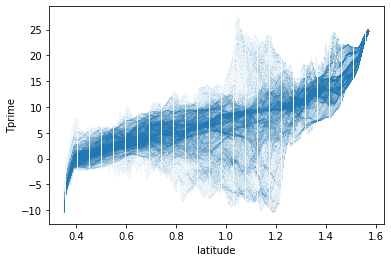

In [7]:
times = data_df.time.values
week_to_eval = times[5]
plt.plot(data_df.latitude[times==week_to_eval]*,data_df['t_prime'][times==week_to_eval],alpha=0.05,marker=',')
plt.xlabel('latitude')
plt.ylabel('Tprime')

#### de-mean at the T' and phi_eq level

interpolated lat eff


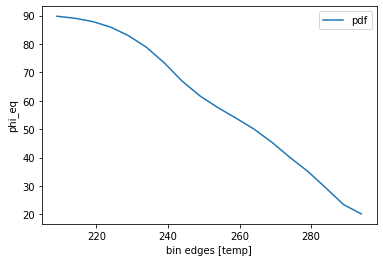

NameError: name 'week_to_eval' is not defined

In [6]:
#reset dataframe
data_df=data_xr.to_dataframe()
data_df.reset_index(drop=False,inplace=True)

edgs,lat_eqs = run_them_all(data_df,de_mean_after=True,pl=False)
prob_plots(edgs,lat_eqs*180/np.pi,'phi_eq')

Text(0, 0.5, 'Tprime')

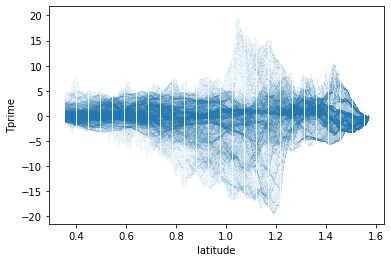

In [8]:
times = data_df.time.values
week_to_eval = times[5]
plt.plot(data_df.latitude[times==week_to_eval],data_df['t_prime_demeaned'][times==week_to_eval],alpha=0.05,marker=',')
plt.xlabel('latitude')
plt.ylabel('Tprime')

one week!


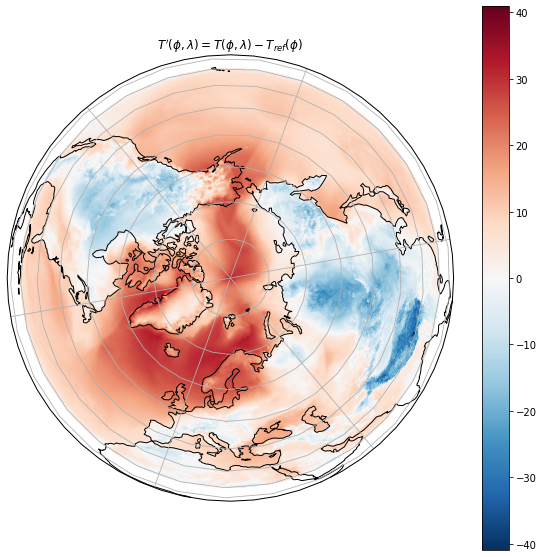

<xarray.DataArray (lat: 280, lon: 1440)>
array([[33.93539429, 33.93539429, 33.93539429, ..., 33.93539429,
        33.93539429, 33.93539429],
       [33.14471436, 33.14555359, 33.14471436, ..., 33.14974976,
        33.14889526, 33.14723206],
       [31.0385133 , 31.03685009, 31.03685009, ..., 31.04521191,
        31.041031  , 31.03935253],
       ...,
       [-2.07451306, -1.91136609, -2.16655408, ..., -1.48799573,
        -1.86784803, -1.98247205],
       [-1.9752228 , -2.00870058, -2.1559479 , ..., -1.87231753,
        -2.1550934 , -2.03296206],
       [-1.9093798 , -1.93782218, -1.88847526, ..., -2.07087882,
        -2.23988517, -2.07338126]])
Coordinates:
  * lat      (lat) float64 90.0 89.75 89.5 89.25 89.0 ... 21.0 20.75 20.5 20.25
  * lon      (lon) float64 0.0 0.25 0.5 0.75 1.0 ... 359.0 359.2 359.5 359.8

In [19]:
convert_to_xarray(data_df[data_df.time.isin(['1980-12-02'])]['t_prime'],plot=True,contour=False, contours=None, 
                      savetitle = None,
                      numweeks=1
                     )

one week!


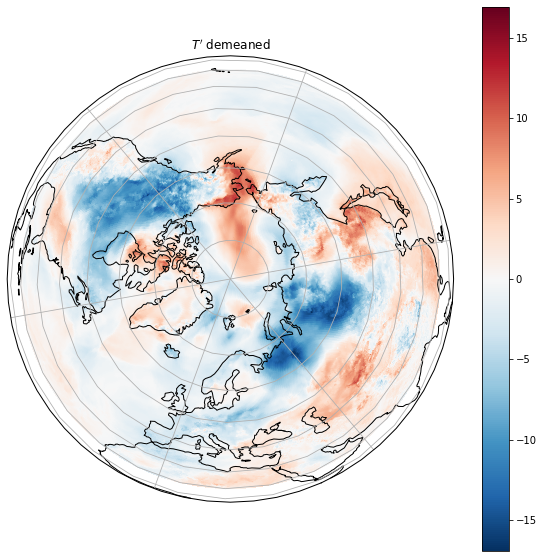

<xarray.DataArray (lat: 280, lon: 1440)>
array([[-2.1771698 , -2.1771698 , -2.1771698 , ..., -2.1771698 ,
        -2.1771698 , -2.1771698 ],
       [-2.87153625, -2.87111664, -2.87069702, ..., -2.86985779,
        -2.87028503, -2.87111664],
       [-3.30330658, -3.30371094, -3.30329132, ..., -3.29995728,
        -3.30162048, -3.30245972],
       ...,
       [-1.99240112, -1.72257996, -1.68045044, ..., -1.6713562 ,
        -1.9631958 , -2.0697937 ],
       [-1.94137573, -1.79344177, -1.81820679, ..., -1.83306885,
        -2.03215027, -2.05194092],
       [-1.78617859, -1.73175049, -1.73782349, ..., -1.95788574,
        -1.92153931, -1.89302063]])
Coordinates:
  * lat      (lat) float64 90.0 89.75 89.5 89.25 89.0 ... 21.0 20.75 20.5 20.25
  * lon      (lon) float64 0.0 0.25 0.5 0.75 1.0 ... 359.0 359.2 359.5 359.8

In [17]:
convert_to_xarray(data_df[data_df.time.isin(['1980-12-02'])]['t_prime_demeaned'],plot=True,contour=False, contours=None, 
                      titlestr=r"$T' $ demeaned", savetitle = None,
                      numweeks=1
                     )

one week!


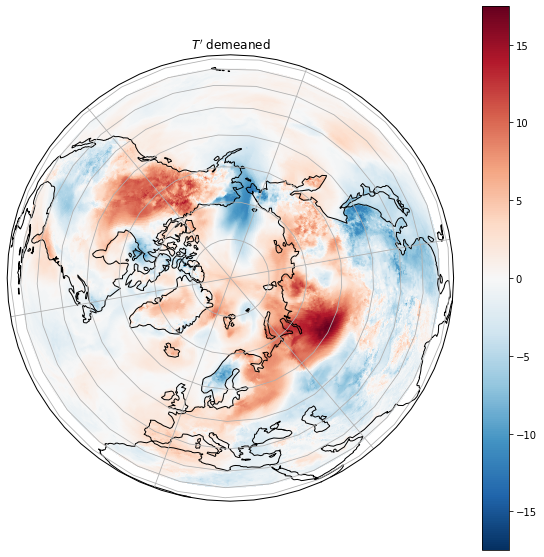

<xarray.DataArray (lat: 280, lon: 1440)>
array([[4.28821564, 4.28821564, 4.28821564, ..., 4.28821564, 4.28821564,
        4.28821564],
       [4.84670258, 4.84587097, 4.8441925 , ..., 4.84670258, 4.84670258,
        4.84670258],
       [5.14432526, 5.14306641, 5.14138794, ..., 5.14516449, 5.14432526,
        5.14432526],
       ...,
       [0.98028564, 0.86499023, 0.82098389, ..., 0.9367218 , 0.93695068,
        0.97073364],
       [0.79475403, 0.67988586, 0.7197876 , ..., 0.87374878, 0.8611145 ,
        0.83807373],
       [0.4960022 , 0.39193726, 0.4949646 , ..., 0.7363739 , 0.67501831,
        0.61523438]])
Coordinates:
  * lat      (lat) float64 90.0 89.75 89.5 89.25 89.0 ... 21.0 20.75 20.5 20.25
  * lon      (lon) float64 0.0 0.25 0.5 0.75 1.0 ... 359.0 359.2 359.5 359.8

In [18]:
convert_to_xarray(data_df[data_df.time.isin(['1981-12-02'])]['t_prime_demeaned'],plot=True,contour=False, contours=None, 
                      titlestr=r"$T' $ demeaned", savetitle = None,
                      numweeks=1
                     )

In [26]:
data_df.head()

,latitude,longitude,time,t2m,t_ref,t_prime,lat_eff,phi_prime,doy,lat_eff_demeaned,t_prime_demeaned
0,1.570796,0.0,1980-12-01,242.247635,209.0,33.247635,1.206456,0.364341,336,0.078241,-4.288216
1,1.570796,0.0,1980-12-02,242.935394,209.0,33.935394,1.190963,0.379834,337,0.041910,-2.177170
2,1.570796,0.0,1980-12-03,247.597473,209.0,38.597473,1.101545,0.469251,338,0.021183,-1.291122
3,1.570796,0.0,1980-12-04,250.072418,209.0,41.072418,1.060713,0.510084,339,-0.055007,3.119339
4,1.570796,0.0,1980-12-05,246.266296,209.0,37.266296,1.125758,0.445038,340,-0.028679,1.491287


computed areas
did area hist


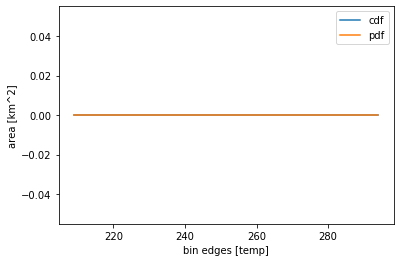

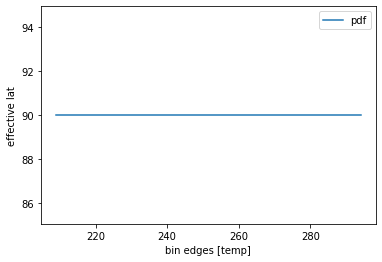

,latitude,longitude,time,t2m,doy,t_ref,t_prime,lat_eff,phi_prime
0,1.570796,0.000000,1980-12-01,-4.288223,336,209.0,-213.288223,1.570796,4.371139e-08
166,1.570796,0.004363,1980-12-01,-4.288223,336,209.0,-213.288223,1.570796,4.371139e-08
332,1.570796,0.008727,1980-12-01,-4.288223,336,209.0,-213.288223,1.570796,4.371139e-08
498,1.570796,0.013090,1980-12-01,-4.288223,336,209.0,-213.288223,1.570796,4.371139e-08
664,1.570796,0.017453,1980-12-01,-4.288223,336,209.0,-213.288223,1.570796,4.371139e-08
...,...,...,...,...,...,...,...,...,...
66930370,0.353429,6.261369,1980-12-01,-0.746399,336,294.0,-294.746399,1.570796,-1.217367e+00
66930536,0.353429,6.265732,1980-12-01,-0.755615,336,294.0,-294.755615,1.570796,-1.217367e+00
66930702,0.353429,6.270095,1980-12-01,-0.736389,336,294.0,-294.736389,1.570796,-1.217367e+00
66930868,0.353429,6.274458,1980-12-01,-0.675018,336,294.0,-294.675018,1.570796,-1.217367e+00


In [24]:
times = data_df.time.values
week_to_eval = times[0]

binedgs,cdf_area = dists_of_areas(data_df[times==week_to_eval],plot=True)
pdf_lat_effs = dists_of_lat_eff(cdf_area,binedges=binedgs,plot=True)
# Tprime= T_prime(data_df[times==week_to_eval],binedgs,pdf_lat_effs)
# plt.plot(data_df.latitude[times==week_to_eval],Tprime,alpha=0.05,marker=',')
# plt.xlabel('latitude')
# plt.ylabel('Tprime')
# plt.show()
data_df[times==week_to_eval]

#### original analysis

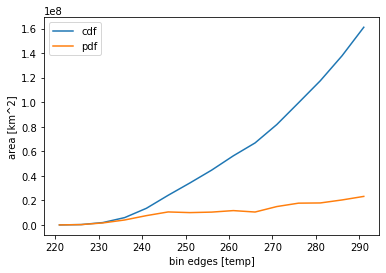

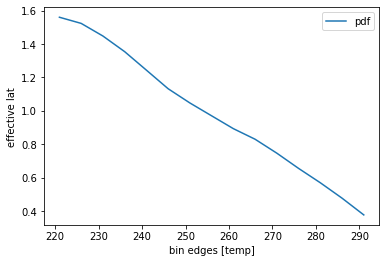

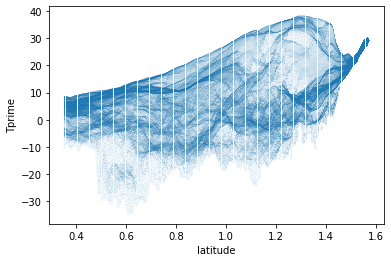

In [199]:
week_to_eval = times[5]
binedgs, pdf_area,cdf_area = dists_of_areas(data_array[times==week_to_eval],plot=True)
pdf_lat_effs = dists_of_lat_eff(cdf_area,binedges=binedgs,plot=True)
Tprime= T_prime(data_array[times==week_to_eval],binedgs,pdf_lat_effs)
plt.plot(data_array.latitude[times==week_to_eval],Tprime,alpha=0.05,marker=',')
plt.xlabel('latitude')
plt.ylabel('Tprime')
plt.show()

#### $\Delta T$ 
for several places. Please never re-run the first cell, it takes forever and the data is saved.

In [57]:
#delta t vs time
#delta t is in reference to the zonal mean evaluated at the same time as the temp we are considering

lat_groups = data_df.groupby('latitude') 
pixel_groups = data_df.groupby(['latitude','longitude'])
#now find the temp at a specific (lat,lon) point
places = dict({'greenland': (71.75,360-42.5), 
               'chicago': (42,360-87.5),
               'hohhot': (41,111.75),
               'barent': (75,40.5),
               'pacific': (41.5,179.5)
              })
numplaces=5

#the deltaT df should have a column for each place, plus a time column which is the same as data_df.time.unique()
deltaT_pd = pd.DataFrame(np.zeros((522,numplaces)),columns=places.keys())
#deltaT_df = dd.from_pandas(deltaT_pd)
for place in places:
    print(place)
    temp_there = pixel_groups.get_group(places[place]).t2m
    ref_temp = lat_groups.get_group(places[place][0]).t2m.mean() #note that this is also a fn of time
    deltaT_pd[place] = ref_temp - temp_there
# temp_at_can = data_df.groupby(['latitude','longitude']).get_group(canada).t2m #.where(dict({'latitude': canada[0],'longitude': canada[1]})).t2m
# ref_can = data_df.groupby('latitude').get_group(canada[0]).t2m.mean() #zonal (add 'time' for temporal)
# delta_T_can = ref_can - temp_at_can

In [55]:
deltaT_pd = pd.read_csv('/project2/geos39650/jet_stream/data/deltaT_weekly.csv')
deltaT_pd['time'] = pd.to_datetime(deltaT_pd['time'])#=deltaT_pd.set_index('time')
places = dict({'greenland': (71.75,360-42.5), 
               'chicago': (42,360-87.5),
               'hohhot': (41,111.75),
               'barent': (75,40.5),
               'pacific': (41.5,179.5)
              })

FileNotFoundError: [Errno 2] File b'/project2/geos39650/jet_stream/data/deltaT_weekly.csv' does not exist: b'/project2/geos39650/jet_stream/data/deltaT_weekly.csv'

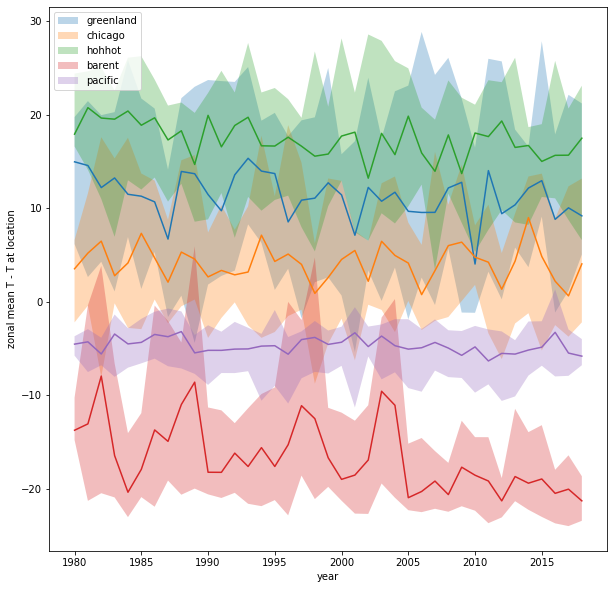

In [53]:
by_year = deltaT_pd.groupby(deltaT_pd['time'].dt.year).agg(['median', 'min', 'max'])

fig= plt.figure(figsize=(10,10))
for place in places:
    mins = by_year[place]['min']
    maxs = by_year[place]['max']
    meds = by_year[place]['median']
    plt.fill_between(by_year.index,mins,maxs,alpha=0.3,label=place)
    plt.plot(meds)
plt.legend(loc='upper left')
plt.xlabel('year')
plt.ylabel('zonal mean T - T at location') 
plt.show()

## Globe Plots

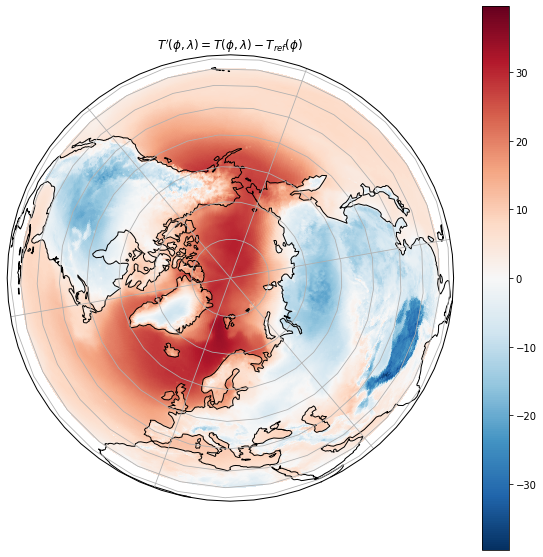

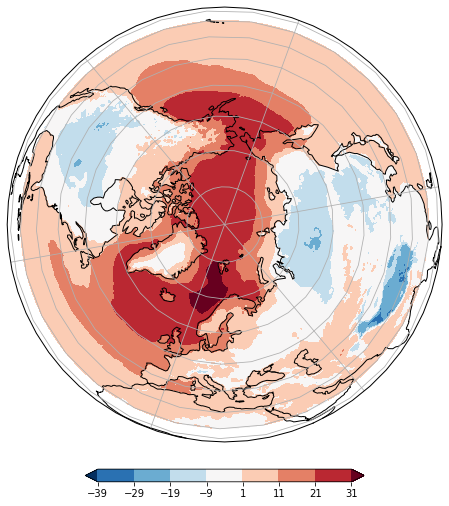

TypeError: can only perform ops with scalar values

In [36]:
#plot T' on a globe
#plt.subplots(figsize = (10, 10))
x_Tp = convert_to_xarray(Tprime,plot=True)
globe_plots(x_Tp,contour=True)
temp=convert_to_xarray(data_array.t2m[times==times[0]],plot=True,titlestr='Temperature')
lat_contours = range(20,90,10)
phi_effs = true_T_to_lat_eff(data_array[times==times[0]],binedgs,pdf_lat_effs)*180/np.pi
x_phi_eff = convert_to_xarray(phi_effs, plot=True,titlestr=r"$\phi_{eff}$",contour=True,contours=lat_contours)

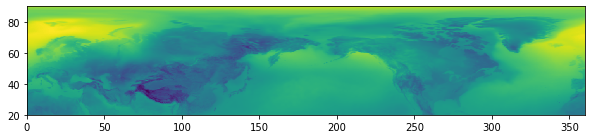

In [63]:
#Alternatively, plot it on a plane
fig, ax = plt.subplots(figsize = (10, 10))
z = np.array(Tprime).reshape((280,1440))
#print(z[:,0])
plt.imshow(z, extent=(0, 360, 20, 90))#, aspect = 'auto')
#plt.colorbar()
plt.show()

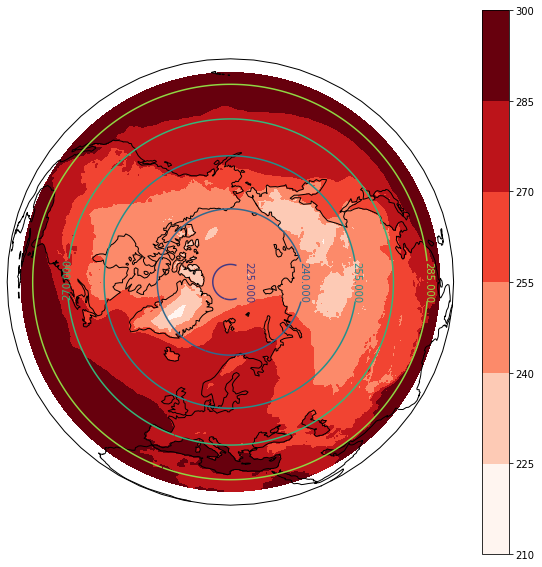

In [66]:
#look at Tref vs T
x_Tref=convert_to_xarray(T_ref_7)
x_temp = convert_to_xarray(data_array.t2m[times==times[7]])
#plot
plt.subplots(figsize = (10, 10))
ax = plt.axes(projection=ccrs.Orthographic(20, 90))
x_temp.plot.contourf(ax=ax,transform=ccrs.PlateCarree(),cmap='Reds')
CS=x_Tref.plot.contour(ax=ax,transform=ccrs.PlateCarree())
ax.clabel(CS, inline=1, fontsize=10)
ax.set_global()
ax.coastlines()

## Histograms!

entries will be the (temp,T',phi_eff) each winter week for a decade at a specific (lat,lon) point

In [16]:
#point to consider
la,lo = (40.5,75) #bearents sea
#temperature
all_temps = data_array.sel(dict(latitude=la,longitude=lo)).t2m
T_bins = np.linspace(all_temps.min(),all_temps.max(),num=30)
num_T_bins = len(T_bins)-1
h_t_all,b_t = np.histogram(all_temps.values,bins=T_bins,density=True)
#tprime and lat_eff
Tp_all,phi_eff_all=run_them_all(data_array.sel(dict(latitude=la,longitude=lo)))
Tp_bins = np.linspace(Tp_all.min(),Tp_all.max(),num=30)
phi_eff_bins = np.linspace(phi_eff_all.min(),phi_eff_all.max(),num=30)
h_tp_all,b_tp=np.histogram(Tp_all,bins=Tp_bins,density=True)

AttributeError: 'DataFrame' object has no attribute 'sel'

In [14]:
#make a multi-dim array with each row being a decade (4 decades) and each column being the entry in each temp bin
num_T_bins = len(Tbins)
h_t_decadal = np.zeros((4,num_T_bins))
#loop over each decade and compute hist for each
for dec in range(4):
    #define the decade
    #make sure it starts in november so we only get december onwards (don't want jan+Feb data)
    start_date = np.datetime64(str(1979+dec*10)+'-11','M') 
    #make sure it ends in april so we get the march data
    end_date = np.datetime64(str(1979+(dec+1)*10)+'-04','M') 
    print('decade %i: '%dec, start_date,end_date)
    
    #get data for just that decade
    dec_temps = data_df.sel(dict(time=slice(start_date,end_date),latitude=la,longitude=lo)).t2m
    
    #for a given decade, fill the histogram with weekly data
    h, b = np.histogram(dec_temps.values,bins=T_bins,density=True)
    h_decadal[dec] = h
    #plt.hist(dec_temps.values,bins=T_bins,histtype='step',label='decade %i'%dec,density=True,alpha=0.6)

# plt.hist(all_temps.values,bins=T_bins,histtype='step',label='total',density=True,alpha=0.6)
# plt.legend()
# plt.xlabel('Temperature (K)')
# plt.show()

decade 0:  1979-11 1989-04


AttributeError: 'DataFrame' object has no attribute 'sel'

In [155]:
dec_temps#.to_array()
#np.datetime64(str(1979+(3)*10)+'-04','M')
#dec_temps.time.max()
#np.datetime64("1979",'Y')
#test_df.t2m['1980' in test_df['time']]

<xarray.DataArray 't2m' (time: 123, latitude: 280, longitude: 1440)>
array([[[245.1468 , 245.1468 , 245.1468 , ..., 245.1468 , 245.1468 ,
         245.1468 ],
        [244.78592, 244.78557, 244.78416, ..., 244.79106, 244.7894 ,
         244.78761],
        [244.49947, 244.49742, 244.49585, ..., 244.50792, 244.50453,
         244.50171],
        ...,
        [290.70602, 290.53812, 290.3165 , ..., 290.6182 , 290.77762,
         290.87515],
        [291.39355, 291.19308, 291.06494, ..., 291.19742, 291.3278 ,
         291.50162],
        [291.99203, 291.8773 , 291.91156, ..., 291.9558 , 291.86343,
         292.01825]],

       [[247.61098, 247.61098, 247.61098, ..., 247.61098, 247.61098,
         247.61098],
        [247.5572 , 247.55672, 247.55685, ..., 247.55876, 247.5579 ,
         247.55733],
        [247.28503, 247.2849 , 247.28416, ..., 247.28801, 247.28667,
         247.2861 ],
        ...,
        [294.9961 , 294.41425, 294.05734, ..., 295.42426, 295.50125,
         295.41473],
        [295.2277 , 294.7305 , 294.61115, ..., 295.83774, 295.84622,
         295.69174],
        [295.30826, 295.03546, 295.05923, ..., 296.21268, 295.93842,
         295.74075]],

       [[249.566  , 249.566  , 249.566  , ..., 249.566  , 249.566  ,
         249.566  ],
        [249.2251 , 249.22511, 249.22522, ..., 249.22534, 249.22498,
         249.2251 ],
        [248.9697 , 248.97002, 248.96988, ..., 248.97096, 248.9706 ,
         248.96965],
        ...,
        [288.54016, 288.2974 , 288.19846, ..., 288.39825, 288.65826,
         288.75772],
        [288.92075, 288.70764, 288.66974, ..., 288.87985, 289.0743 ,
         289.15024],
        [289.19162, 289.09167, 289.1445 , ..., 289.46854, 289.36346,
         289.40317]],

       ...,

       [[249.14584, 249.14584, 249.14584, ..., 249.14584, 249.14584,
         249.14584],
        [249.28154, 249.28261, 249.28296, ..., 249.28027, 249.28075,
         249.2812 ],
        [249.381  , 249.3818 , 249.38283, ..., 249.37744, 249.37865,
         249.3796 ],
        ...,
        [294.54996, 294.18832, 294.0519 , ..., 294.9292 , 294.98688,
         294.88153],
        [294.81277, 294.5305 , 294.5259 , ..., 295.23752, 295.24664,
         295.15427],
        [294.96115, 294.83707, 294.91373, ..., 295.60602, 295.38553,
         295.28387]],

       [[247.33244, 247.33244, 247.33244, ..., 247.33244, 247.33244,
         247.33244],
        [247.23386, 247.23338, 247.23326, ..., 247.23442, 247.23454,
         247.23409],
        [247.31418, 247.31383, 247.31288, ..., 247.31393, 247.31334,
         247.31346],
        ...,
        [294.96832, 294.71127, 294.55038, ..., 294.9607 , 295.16623,
         295.2409 ],
        [295.07474, 294.8386 , 294.81223, ..., 295.2414 , 295.33786,
         295.36856],
        [295.10953, 294.9327 , 295.04663, ..., 295.53262, 295.30566,
         295.3133 ]],

       [[242.90155, 242.90155, 242.90155, ..., 242.90155, 242.90155,
         242.90155],
        [243.0159 , 243.01547, 243.01508, ..., 243.0163 , 243.0163 ,
         243.0159 ],
        [243.16794, 243.16754, 243.16632, ..., 243.16672, 243.16711,
         243.16672],
        ...,
        [296.38226, 296.21667, 296.12735, ..., 295.7171 , 296.05396,
         296.4331 ],
        [296.59784, 296.429  , 296.4265 , ..., 295.92734, 296.1835 ,
         296.61426],
        [296.7368 , 296.61752, 296.7196 , ..., 296.16956, 296.26013,
         296.63885]]], dtype=float32)
Coordinates:
  * time       (time) datetime64[ns] 1980-12-07 1980-12-14 ... 1989-03-05
  * longitude  (longitude) float32 0.0 0.25 0.5 0.75 ... 359.25 359.5 359.75
  * latitude   (latitude) float32 90.0 89.75 89.5 89.25 ... 20.75 20.5 20.25

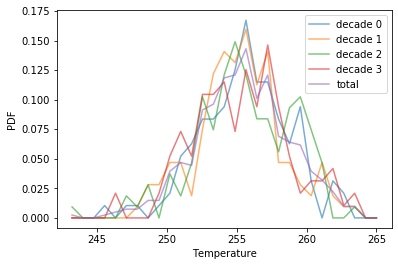

In [187]:
#plot all hists plus the total
for dec in range(4):
    plt.plot(b[1:],h_decadal[dec],label='decade %i'%dec,alpha=0.6)

plt.plot(b[1:],h_all,label='total',alpha=0.6)
plt.legend()
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.show()

In [36]:
a = test_df.sel(dict(latitude=la,longitude=lo)).to_dataframe()

In [45]:
a[a.t2m.isna() == True].index.month.unique()

Int64Index([3, 4, 5, 6, 7, 8, 9, 10, 11], dtype='int64', name='time')

## Tests and messing around

In [47]:
#experimentation with smaller df
#1 and 2 are lat,lon and 0 is temp, 300 is the number of time instances
another_df = pd.DataFrame(np.ones((300,3)))
another_df[0] = np.random.uniform(size=300)
another_df[2] = np.hstack((np.zeros(100),np.ones(200))) 
#sums = another_df.groupby([1,2]).sum() 
#another_df.groupby([1,2]).sub(another_df.groupby([1,2])[0].mean())
#groupby, then apply (lambda x sum - x)
de_meaned_temp = another_df.groupby([1,2])[0].apply(lambda x: x- x.mean() )

In [13]:
#this works!
tiny_groups = data_df.groupby(by=[data_df.time.dt.dayofyear,'latitude','longitude'])['t2m'].mean() #as_index=False

tiny_groups.rename_axis(index={'time':'doy'},inplace=True)
meaned_df = tiny_groups.reset_index(drop=False)
data_df['doy'] = data_df.time.dt.dayofyear #works but only need to do it once!
# tiny_groups.rename({'time':'doy'}) #this doesn't do anything? and it takes forever

print(len(data_df['doy']),len(meaned_df['doy']))
merged_df = data_df.merge(meaned_df,left_on=['doy','latitude','longitude'],right_on=['doy','latitude','longitude'],
              how='left',suffixes=('_original','_mean'))

merged_df['t2m'] = merged_df['t2m_original'] -merged_df['t2m_mean'] #does the replacement work??

#### attempt 0
this one is wrong by design - it takes a global mean instead of by each point

computed areas
did area hist


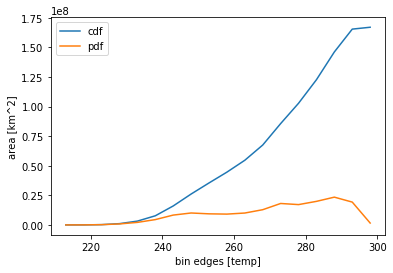

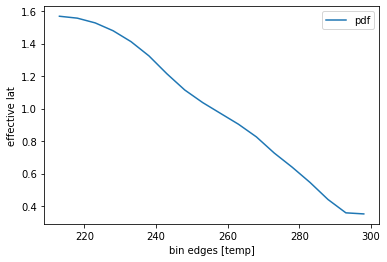

interpolated lat eff
CPU times: user 12.8 s, sys: 4.64 s, total: 17.5 s
Wall time: 17.6 s


,latitude,longitude,time,t2m,t_ref,t_prime,lat_eff,phi_prime,le_dm,tp_dm
0,1.570796,0.000000,1980-12-01,242.247635,213.00000,29.247635,1.230686,0.340111,0.411754,20.701214
1,1.570796,0.000000,1980-12-02,242.935394,213.00000,29.935394,1.215574,0.355222,0.396642,21.388973
2,1.570796,0.000000,1980-12-03,247.597473,213.00000,34.597473,1.122138,0.448659,0.303206,26.051052
3,1.570796,0.000000,1980-12-04,250.072418,213.00000,37.072418,1.082007,0.488789,0.263075,28.525997
4,1.570796,0.000000,1980-12-05,246.266296,213.00000,33.266296,1.148781,0.422016,0.329849,24.719875
...,...,...,...,...,...,...,...,...,...,...
72575995,0.353429,6.278822,2018-02-24,296.081177,296.36689,-0.285713,0.353809,-0.000380,-0.465123,-8.832135
72575996,0.353429,6.278822,2018-02-25,294.882446,296.36689,-1.484444,0.355403,-0.001974,-0.463529,-10.030865
72575997,0.353429,6.278822,2018-02-26,296.410950,296.36689,0.044060,0.353371,0.000059,-0.465561,-8.502362
72575998,0.353429,6.278822,2018-02-27,299.822632,296.36689,3.455742,0.351258,0.002171,-0.467674,-5.090680


In [68]:
%%time
run_them_all(data_df,de_mean=True, pl=True)
data_df

one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!


/home/afarah/.conda/envs/jetstream/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!
one week!


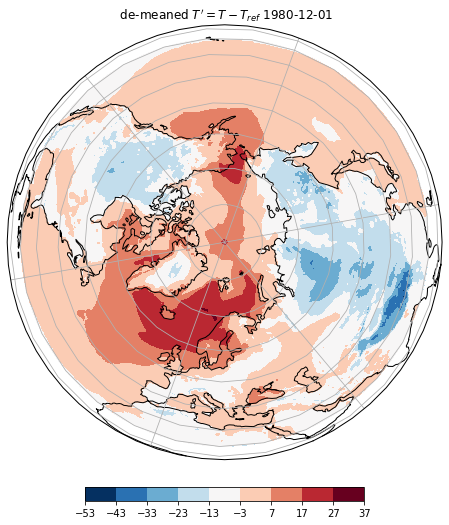

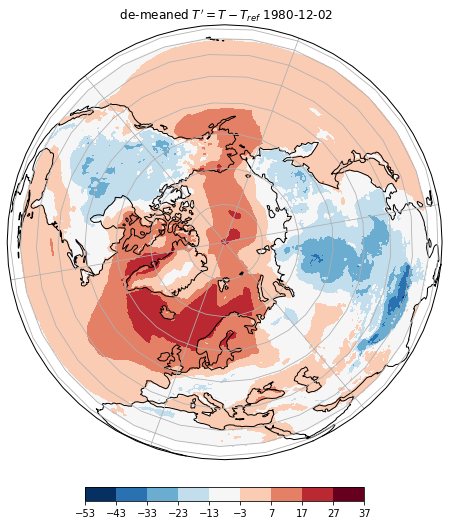

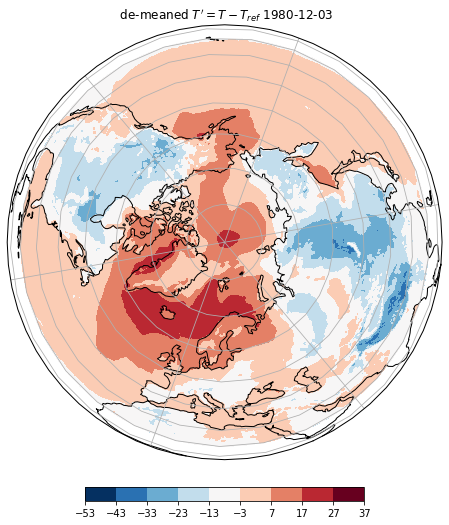

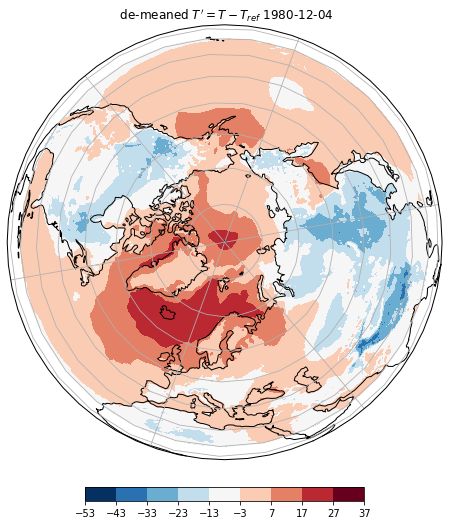

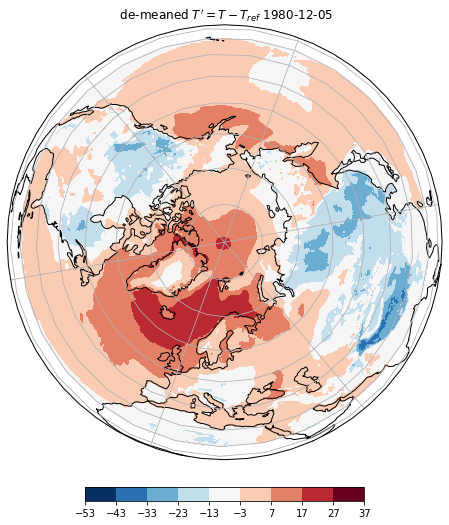

...

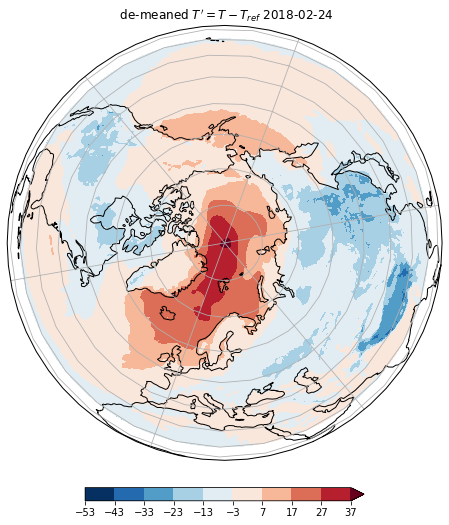

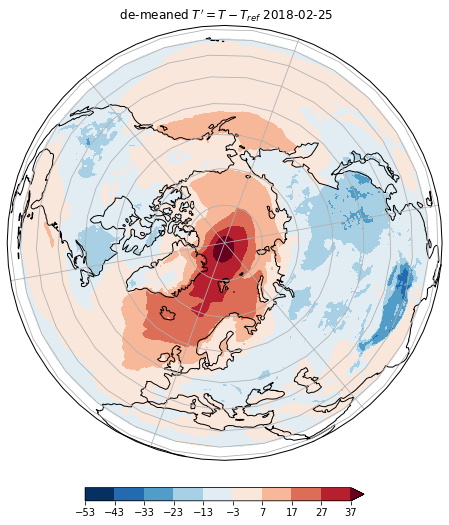

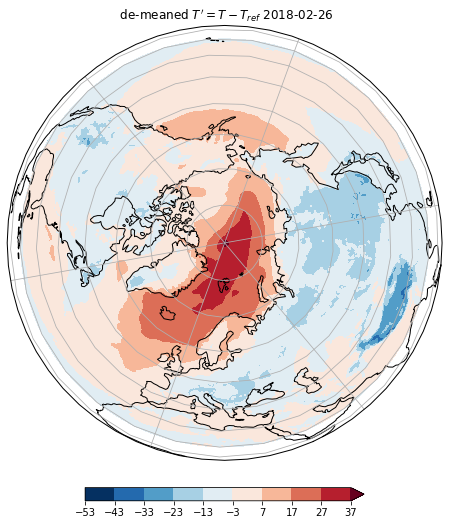

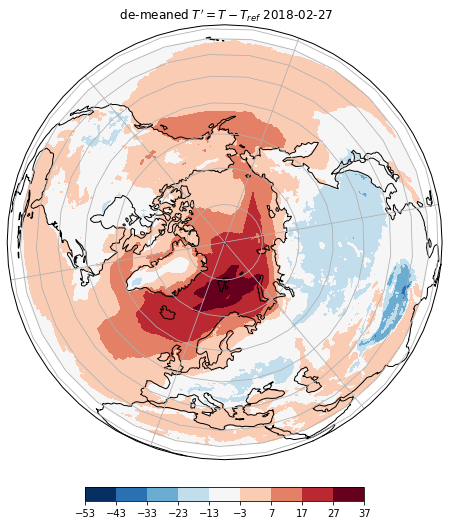

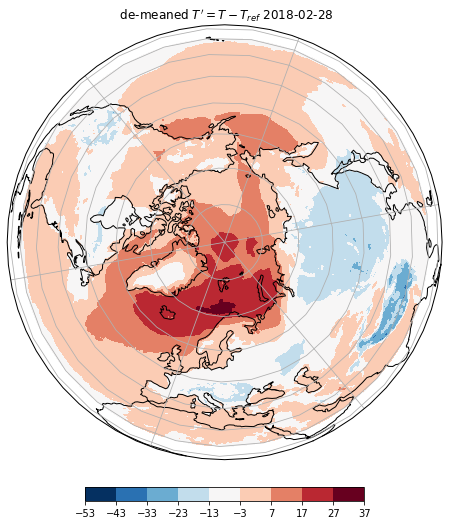

In [100]:
key = 'tp_dm'
conts = range(int(data_df[key].min()),int(data_df[key].max()),10)
for date in selected_dates:
    date_str = date.strftime('%Y-%m-%d')
    convert_to_xarray(data_df[key][data_df.time==date],
                      plot=True,titlestr=r" de-meaned $T' = T - T_{ref}$ "+date_str, savetitle=key+date_str,
                      contour=True,contours=conts)

/home/afarah/.conda/envs/jetstream/lib/python3.6/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


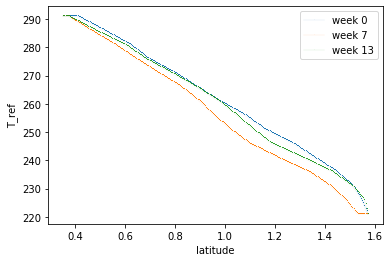

In [65]:
#compare maps of several different weeks
week_to_eval = times[0]
binedgs, pdf_area,cdf_area = dists_of_areas(data_array.t2m[times==week_to_eval],data_array.latitude[times==week_to_eval],plot=False)
pdf_lat_effs = dists_of_lat_eff(cdf_area,binedges=binedgs,plot=False)
T_ref_0 = T_ref(data_array[times==week_to_eval],binedgs,pdf_lat_effs)
week_to_eval = times[7]
binedgs, pdf_area,cdf_area = dists_of_areas(data_array.t2m[times==week_to_eval],data_array.latitude[times==week_to_eval],plot=False)
pdf_lat_effs = dists_of_lat_eff(cdf_area,binedges=binedgs,plot=False)
T_ref_7 = T_ref(data_array[times==week_to_eval],binedgs,pdf_lat_effs)
week_to_eval = times[13]
binedgs, pdf_area,cdf_area = dists_of_areas(data_array.t2m[times==week_to_eval],data_array.latitude[times==week_to_eval],plot=False)
pdf_lat_effs = dists_of_lat_eff(cdf_area,binedges=binedgs,plot=False)
T_ref_13 = T_ref(data_array[times==week_to_eval],binedgs,pdf_lat_effs)

plt.plot(data_array.latitude[times==week_to_eval],T_ref_0,alpha=0.05,marker=',',label='week 0')
plt.plot(data_array.latitude[times==week_to_eval],T_ref_7,alpha=0.05,marker=',',label='week 7')
plt.plot(data_array.latitude[times==week_to_eval],T_ref_13,alpha=0.05,marker=',',label='week 13')
plt.xlabel('latitude')
plt.ylabel('T_ref')
plt.legend()
plt.show()

In [55]:
b,c = dists_of_areas(data_df)
# le = dists_of_lat_eff(c,b)
# Tref = T_ref(data_df,b,le)
# Tref_df_simple = ddf.from_array(Tref) #this doesn't work as expected - maybe because the array should have 2 dims or have a record dtype?
#Tref_df = ddf.from_array(np.vstack((Tref,data_df.latitude)))

computed areas
did hist


In [62]:
data_df['t_ref'] = data_df.latitude.apply(lambda x: T_ref(x,b,le), meta='keyword')

In [73]:
#data_df['t_ref']=data_df.t_ref.astype(np.float32)
tp_df = data_df.t2m - data_df['t_ref']
#print(len(Tref),Tref_df.shape)
#Tref_df.compute() #ahh for the non-vstacked, this is way smaller than t2m, but why?

In [23]:
# plt.plot(Tref)
# plt.show()
Tprime =  data_df.t2m - Tref_df #has nans!
print('subtracted')
(data_df.t2m - Tref_df).compute() #smh doesnt work. and took foreverrr

subtracted


,0,1,2,3,4,5,6,7,8,9,...,403190,403191,403192,403193,403194,403195,403196,403197,403198,403199
0,20.146805,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,243.576008,243.576008,243.576008,243.576008,243.576008,243.576008,243.576008,243.576008,243.576008,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


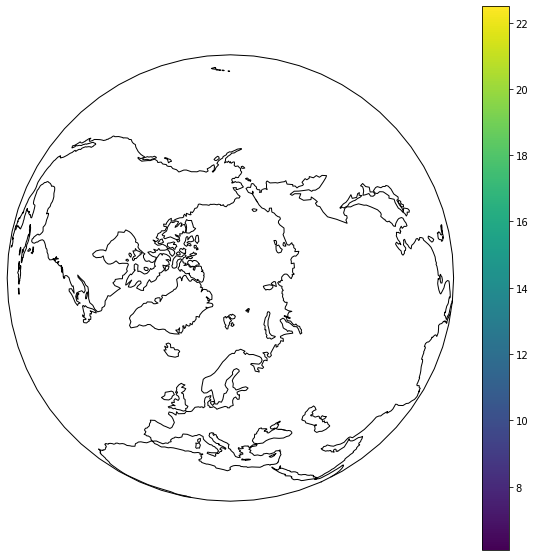

In [82]:
# temps=data_df.to_dask_array()
# temps.compute_chunk_sizes()
plt.subplots(figsize = (10, 10))
ax = plt.axes(projection=ccrs.Orthographic(20, 90))
ax.set_global()
ax.coastlines()
ax.plot(data_df.longitude*180/np.pi, 
            data_df.latitude*180/np.pi, 
            temps)

In [5]:
test_df =xr.load_dataset("/project2/geos39650/jet_stream/data/df_lat_20_1W.nc")

In [4]:
data_array_w1 = data_array.isel(time=0).to_dataframe().reset_index(drop=False)

AttributeError: 'DataFrame' object has no attribute 'isel'

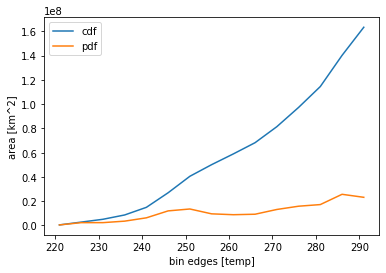

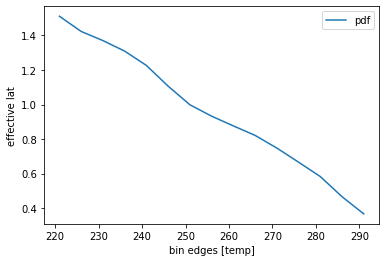

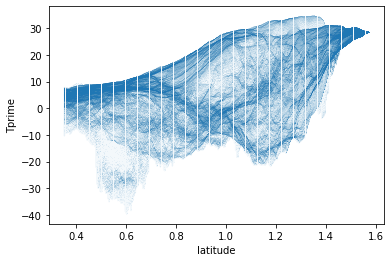

In [35]:
binedgs, pdf_area,cdf_area = dists_of_areas(data_array_w1.t2m,data_array_w1.latitude,plot=True)
pdf_lat_effs = dists_of_lat_eff(cdf_area,binedges=binedgs,plot=True)
Tprime= T_prime(data_array_w1,binedgs,pdf_lat_effs)
plt.plot(data_array_w1.latitude,Tprime,alpha=0.05,marker=',')
plt.xlabel('latitude')
plt.ylabel('Tprime')
plt.show()

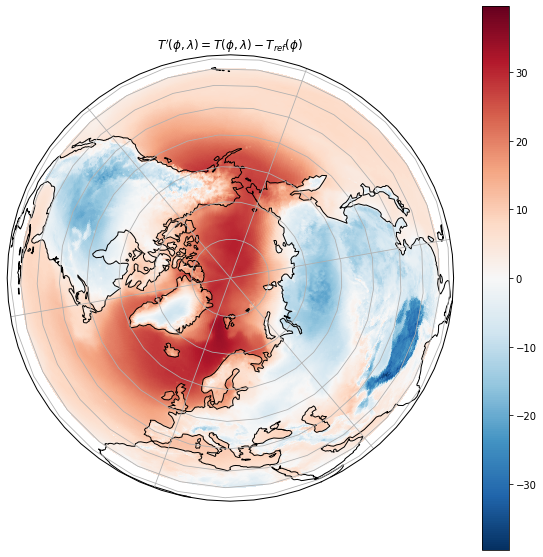

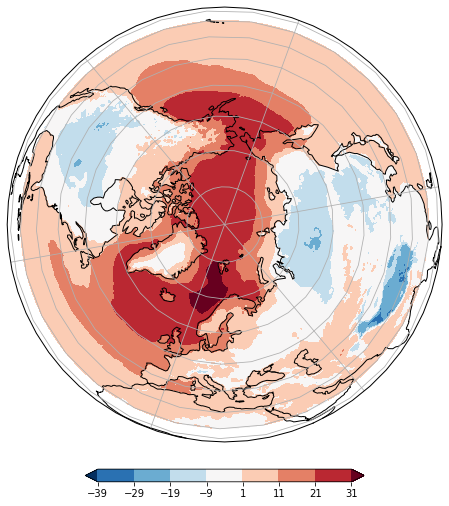

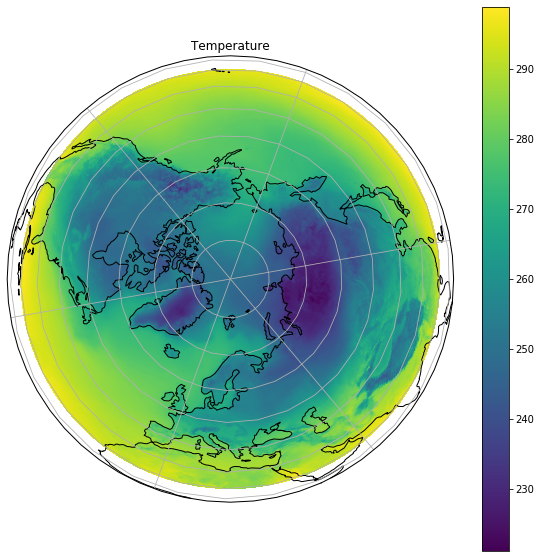

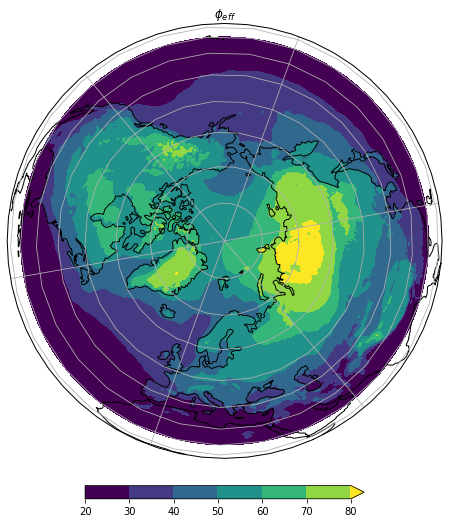

In [37]:
#plot T' on a globe
#plt.subplots(figsize = (10, 10))
x_Tp = convert_to_xarray(Tprime,plot=True)
globe_plots(x_Tp,contour=True)
temp=convert_to_xarray(data_array_w1.t2m,plot=True,titlestr='Temperature')
lat_contours = range(20,90,10)
phi_effs = true_T_to_lat_eff(data_array_w1,binedgs,pdf_lat_effs)*180/np.pi
x_phi_eff = convert_to_xarray(phi_effs, plot=True,titlestr=r"$\phi_{eff}$",contour=True,contours=lat_contours)

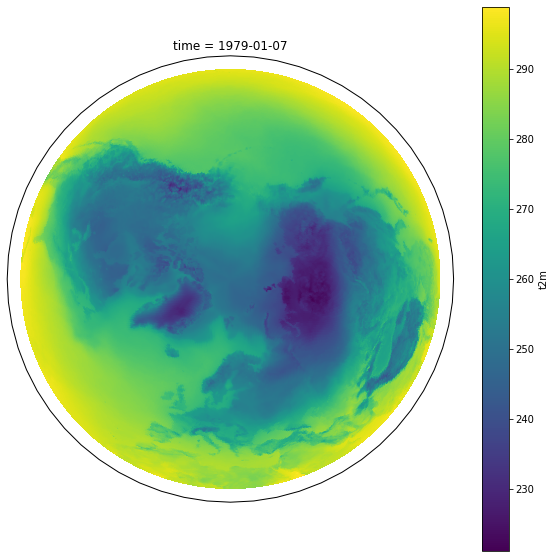

In [25]:
plt.subplots(figsize = (10, 10))
ax = plt.axes(projection=ccrs.Orthographic(20, 90))
test_df.t2m[0].plot(ax=ax,transform=ccrs.PlateCarree())

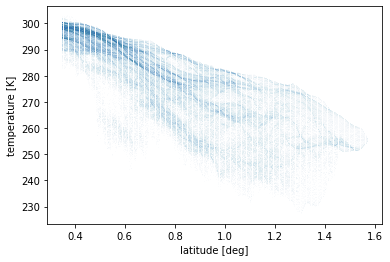

In [21]:
plt.plot(lats[times==times[0]]*180/np.pi,Temps[times==times[0]], marker=',',alpha=0.015)
plt.xlabel('latitude [deg]')
plt.ylabel('temperature [K]')
plt.show()

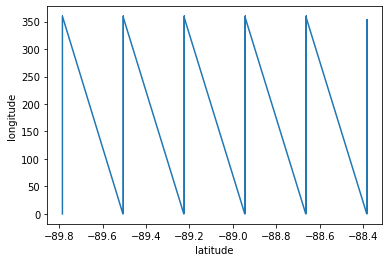

In [29]:
plt.plot(lat[:1000000],air_week_df['lon'][:1000000],marker=',')
plt.xlabel('latitude')
plt.ylabel('longitude')
plt.show()

In [14]:
print(air.groupby(['time'], as_index=False)['t2m'].count())

         time     t2m
0  2007-12-02  542080
1  2007-12-09  542080
2  2007-12-16  542080
3  2007-12-23  542080
4  2007-12-30  542080
5  2008-01-06  542080
6  2008-01-13  542080
7  2008-01-20  542080
8  2008-01-27  542080
9  2008-02-03  542080
10 2008-02-10  542080
11 2008-02-17  542080
12 2008-02-24  542080
13 2008-03-02  542080


In [53]:
#angular resolution (lon) of reported temp data is coarser at poles (Every 20deg) than at mid-lat (~every 2 deg). 
#at equator, its every 0.33? deg
#this makes sense because it would be pretty expensive to have it every 0.25 deg at poles!
first_air_week_df.lon[np.logical_not(np.isnan(first_air_week_df.t2m))][129600:129670]
#print(np.sum(np.logical_not(np.isnan(first_air_week_df.t2m))),len(first_air_week_df.t2m))

2465393    160.96
2465404    161.28
2465413    161.60
2465423    161.92
2465432    162.24
            ...  
2466082    181.76
2466092    182.08
2466102    182.40
2466113    182.72
2466123    183.04
Name: lon, Length: 70, dtype: float64

In [ ]:
#-------test whether ivans thing counts the nans ---------# (never ran)
air_week_df = air_week_df.assign(temp_bracket =  pd.cut(air_week_df['t2m'], cut_off))
air_week_df_high = air_week_df[air_week_df.lat > 20]
air_week_df_group_north_pdf = ai
r_week_df_north.groupby(['temp_bracket', 'time'], as_index=False)['lat'].count()
# Calculate cumulative number of grids per temperature bins
air_week_df_group_north_cdf = air_week_df_group_north_pdf.assign(lat_cumsum = air_week_df_group_north_pdf.lat.cumsum())
air_week_df_group_north_cdf['left_temp_interval']  = air_week_df_group_north_cdf.temp_bracket.apply(lambda x: x.left)

In [16]:
len(air_week.isel(time=5)['lat'])

640

In [69]:
np.all(ds_grib['values']['lon']==ds_grib['longitude'])#['longitude'][(ds_grib['latitude']<0.4)&(ds_grib['latitude']> 0)]

<xarray.DataArray ()>
array(True)
Coordinates:
    number   int64 0
    step     timedelta64[ns] 00:00:00
    surface  int64 0

In [79]:
len(ds_grib['longitude'][ds_grib['latitude']>89.78])

18

In [81]:
ds_grib_cut = ds_grib[[ds_grib['latitude']>20]]

KeyboardInterrupt: 

In [ ]:
ds_grib_cut

In [86]:
np.isnan(ds_grib_reshaped)

<xarray.Dataset>
Dimensions:     (lat: 640, lon: 11942, time: 184)
Coordinates:
    number      int64 0
  * time        (time) datetime64[ns] 2007-12-01 ... 2008-03-01T12:00:00
    step        timedelta64[ns] 00:00:00
    surface     int64 0
    latitude    (lon, lat) float64 -89.78 -89.51 -89.23 -88.95 ... nan nan nan
    longitude   (lon, lat) float64 0.0 0.0 0.0 0.0 0.0 ... nan nan nan nan nan
    valid_time  (time) datetime64[ns] 2007-12-01 ... 2008-03-01T12:00:00
  * lon         (lon) float64 0.0 0.2812 0.2963 0.3 ... 359.7 359.7 359.7 359.7
  * lat         (lat) float64 -89.78 -89.51 -89.23 -88.95 ... 89.23 89.51 89.78
Data variables:
    t2m         (time, lon, lat) bool False False False False ... True True True

In [94]:
ds_grib_week = ds_grib.resample(time='1W').mean()
df_grib_week = ds_grib_week.to_dataframe().filter(['latitude', 'longitude', 't2m'])
a = df_grib_week.reset_index(drop=False)
a = a[a.time == '2007-12-02']
a_group = a.groupby(['latitude'], as_index=False).longitude.count()

KeyError: ('latitude', 'longitude', 't2m')

In [91]:
ds_grib

<xarray.Dataset>
Dimensions:     (time: 184, values: 542080)
Coordinates:
    number      int64 0
  * time        (time) datetime64[ns] 2007-12-01 ... 2008-03-01T12:00:00
    step        timedelta64[ns] 00:00:00
    surface     int64 0
    latitude    (values) float64 89.78 89.78 89.78 ... -89.78 -89.78 -89.78
    longitude   (values) float64 0.0 20.0 40.0 60.0 ... 280.0 300.0 320.0 340.0
    valid_time  (time) datetime64[ns] 2007-12-01 ... 2008-03-01T12:00:00
  * values      (values) MultiIndex
  - lon         (values) float64 0.0 20.0 40.0 60.0 ... 280.0 300.0 320.0 340.0
  - lat         (values) float64 89.78 89.78 89.78 ... -89.78 -89.78 -89.78
Data variables:
    t2m         (time, values) float32 247.30748 247.49889 ... 224.41501
Attributes:
    GRIB_edition:            1
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts
    history:                 2020-01-30T21:06:00 GRIB to CDM+CF via cfgrib-0....

In [57]:
data_array = pd.read_csv('/project2/geos39650/jet_stream/data/t2m_temp_1207_0208.csv')

In [51]:
#fig, ax = plt.subplots(figsize = (20, 20))
print(len(data_array.t2m)/14)
#temp_grid = np.array(data_array['t2m'])
#temp_grid_week1 = temp_grid[:int(len(data_array.t2m)/13)]
#plt.plot(data_array.latitude,data_array.longitude,marker=',')
print(1440*720)
#plt.show()
#temp_grid = temp_grid.resize((len(data_array.latitude),len(data_array.longitude)))
#data_array.plot()

403200.0
1036800


In [55]:
data_array = pd.read_csv('/project2/geos39650/jet_stream/data/t2m_temp_1207_0208.csv')
data_array.set_index(['latitude', 'longitude', 'time'], inplace=True)
data_array.count()

t2m             5644800
area_grid       5644800
temp_bracket    5644800
dtype: int64

TypeError: Invalid shape (5644800,) for image data

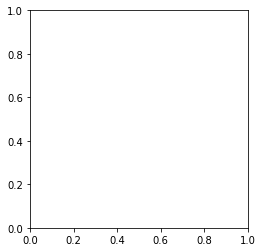

In [74]:
plt.imshow((np.array(data_array.t2m).reshape

In [87]:
np.array(data_array.t2m[:5643000]).reshape((2375,2376))

array([[255.99916, 257.67792, 254.5231 , ..., 243.21518, 246.89442,
        247.59566],
       [252.9362 , 248.91232, 247.85942, ..., 250.6471 , 249.62552,
        249.91008],
       [246.69974, 243.21518, 246.89442, ..., 247.29417, 255.99916,
        257.67792],
       ...,
       [297.2029 , 296.51587, 296.79306, ..., 291.19803, 291.05746,
        291.5383 ],
       [294.55444, 293.53278, 292.57053, ..., 295.43552, 295.62686,
        293.85608],
       [295.4376 , 295.53394, 295.70703, ..., 295.99722, 295.9684 ,
        295.73315]])

In [97]:
len(np.array(data_array.t2m))/1440/14

280.0

In [113]:
z = np.array(data_array.t2m).reshape((280,1440,14))
len(z[0])

1440

In [98]:
(90-20)*4

280

#### attempt 2

In [31]:
def f(group):
    return pd.DataFrame({'original': group,
                         'demeaned': group - group.mean()})
tiny_groups = data_df.groupby(by=[data_df.time.dt.dayofyear,'latitude','longitude']) #as_index=False
tiny_groups.t2m.mean() - tiny_groups.t2m #i interupted after a few minutes

KeyboardInterrupt: 

#### attempt 3

In [45]:
selected_dates = pd.date_range('1980-12-01',periods=12*7-1,freq='D').union(pd.date_range(end='2018-02-28',periods=12*7-1,freq='D'))
latitude_coords = np.flip(np.arange(20.25,90.001,step=0.25))
longitude_coords = np.arange(0,360,step=0.25)
days_of_year = selected_dates.dayofyear#[0],selected_dates.dt.dayofyear.max[-1])
d = ('latitude','longitude','doy','time')
c = {'latitude':latitude_coords,'longitude':longitude_coords,'doy':days_of_year,'time':selected_dates}
mock_temp = np.random.uniform(low=260,high=350,
                              size=280*1440*len(days_of_year)*len(selected_dates)).reshape((280,1440,len(days_of_year),len(selected_dates)))
xarr_2 = xr.DataArray(mock_temp, dims = d, coords = c)

MemoryError: Unable to allocate 82.8 GiB for an array with shape (11110579200,) and data type float64

## Code for when data was in .grib files
and in a reduced gaussian grid

In [4]:
#load data
ds_grib = xr.load_dataset(
    '/project2/geos39650/jet_stream/reanalysis_getter/cdsapi_requested_files/cds_dec07-feb08_12hrs.grib', 
    engine='cfgrib')

#fix indexing because the way it is done by default is stupid
index = pd.MultiIndex.from_arrays(
    [ds_grib.longitude.values, 
     ds_grib.latitude.values], 
    names=['lon', 'lat']
)
ds_grib['values'] = index

ds_grib_reshaped = ds_grib.unstack('values')


In [8]:
#air = ds_grib_reshaped.t2m.T
air = ds_grib_reshaped.t2m.T

#average each week
air_week = air.resample(time='1W').mean()
air_week_df = air_week.to_dataframe()
air_week_df = air_week_df.reset_index(drop=False).filter(['lat', 'lon', 'time', 't2m'])

/home/afarah/.conda/envs/jetstream/lib/python3.6/site-packages/xarray/core/dataarray.py:1897: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  return self.transpose()


In [ ]:
fig, ax = plt.subplots(figsize = (10, 10))
air.isel(time=100).plot()

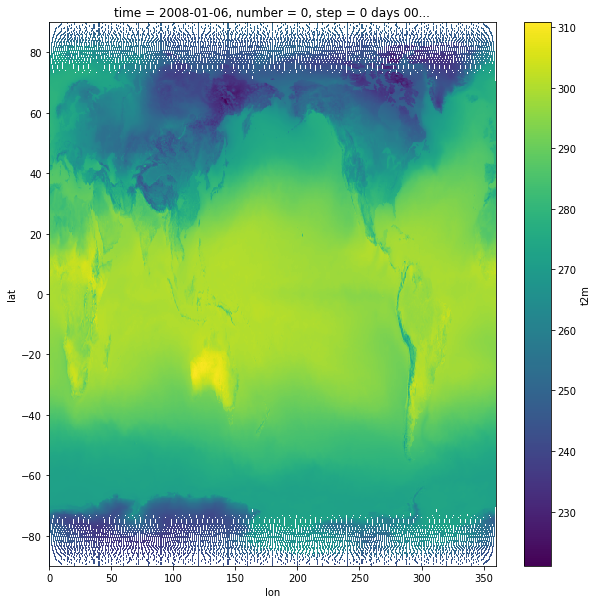

In [11]:
fig, ax = plt.subplots(figsize = (10, 10))
air_week.isel(time=5).plot() 

In [10]:
#--- MOAR FORMATTING! ----#
#lets just look at the first week
# first_air_week = air_week.isel(time=0)
# first_air_week_df = first_air_week.to_dataframe()
# first_air_week_df = first_air_week_df.reset_index(drop=False).filter(['lat', 'lon', 'time', 't2m'])

# Temp = first_air_week_df['t2m'][first_air_week_df['lat']>20] 
# Temp = np.linspace(Tmin,Tmax,num=100)
# Temp += np.random.normal(loc=50,scale=50, size=100)

#ok now look at all of the weeks
weeks = range(13)
all_weeks_df =air_week.isel(time=weeks).to_dataframe().reset_index(drop=False).filter(['lat', 'lon', 'time', 't2m'])
#put a cut to only look above ~mexico
lat_cut_bools = all_weeks_df['lat']>20 
# temp_all_weeks_df = all_weeks_df['t2m'][lat_cut_bools] 

#dataframes ill be using as inputs to functions
Temps = all_weeks_df['t2m'][lat_cut_bools] 
times = all_weeks_df['time']
lats  = all_weeks_df['lat'][lat_cut_bools]*np.pi/180.

#make temp bins
Tmin = min(Temps)
Tmax = max(Temps) #kelvin
Tbins = range(int(Tmin),int(Tmax),5)

In [50]:
#all analysis functions
def plots(binedges,pdf,cdf,xlab):
    plt.plot(cdf,binedges,label='cdf')
    plt.plot(pdf,binedges,label='pdf')
    plt.ylabel('bin edges [temp]')
    plt.xlabel(xlab)
    plt.legend()
    plt.show()
    
def dists_of_boxes(temp_df,plot=False):
    #number of boxes at each temp
    pdf_boxes, binedges = np.histogram(temp_df,bins=Tbins)
    #number of boxes below each temp
    cdf_boxes=np.cumsum(pdf_boxes)
    if plot:
        plots(binedges[:-1],pdf_boxes,cdf_boxes,'number of boxes')
    return binedges[:-1], pdf_boxes, cdf_boxes

#area 
def dists_of_areas(temp_df,lat,plot=False):
    #weight entry by box area so that y axis is no longer the number of boxes, but rather the area taken up by each box
    #this is the area of each grid cell
    #lat = air_df['lat'][air_df['lat']>20]*np.pi/180. #np.linspace(np.pi/2.,np.pi/2.*(1-1/4.),num=100)
    areas = (R_earth*dphi)**2 * np.cos(lat)
    pdf_areas, binedges = np.histogram(temp_df,bins=Tbins,weights=areas)
    cdf_areas=np.cumsum(pdf_areas)
    if plot:
        plots(binedges[:-1],pdf_areas,cdf_areas,'area [km^2]')

    return binedges[:-1], pdf_areas, cdf_areas

#convert area to effective latitude
def dists_of_lat_eff(cdf_areas,binedges=None,plot=False):
    """if plot is set to true, must specify binedges"""
    #A = 2piR^2 (1-sin(lat_eff))
    #so 1-A/(2piR^2) = sin(lat_eff)
    #but remember latitude is defined to start at pi at the north pole
    pdf_lat_effs = np.pi/2.-np.arccos(1-cdf_areas / (2*np.pi*R_earth**2) )
    cdf_lat_effs = np.cumsum(pdf_lat_effs)
    if plot:
        plots(binedges,pdf_lat_effs,pdf_lat_effs,'effective lat')
    return pdf_lat_effs

def T_prime(data_array,binedges,pdf_lat_effs):
    #take a lat,lon point
    true_lat = data_array.latitude
    true_long =data_array.longitude
    #calculate T_ref with just the latitude, given the effective lat vs temp contour relation
    T_ref = np.interp(true_lat,pdf_lat_effs,binedges)
    #calculate T'(lat,lon) which is T_true(lat,lon,time) - T_ref(lat,lon,time)
    Tprime = T_ref - data_array.t2m #this is a function of longitude and time
    return Tprime, data_array.longitude, data_array.time

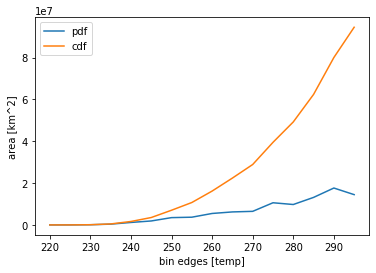

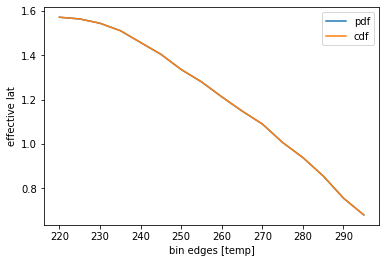

0           NaN
1      1.563757
2      1.516448
3      1.412669
4      1.255504
         ...   
247         NaN
248         NaN
249         NaN
250         NaN
251         NaN
Name: eff_latitude, Length: 252, dtype: float64


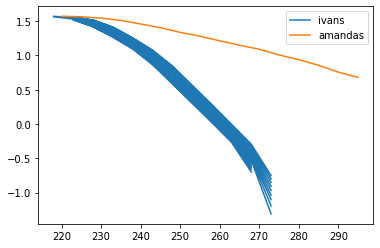

In [13]:
# #test it out with the first week
binedgs, pdf_area,cdf_area = dists_of_areas(Temps[times==times[0]],lats[times==times[0]],plot=True)
pdf_lat_effs = dists_of_lat_eff(cdf_area,binedges=binedgs,plot=True)

#compare with iván's analysis
ivans = pd.read_csv('/project2/geos39650/jet_stream/data/t2m_per_eff_latitude.csv')
print(ivans['eff_latitude'])
plt.plot(ivans['left_temp_interval'],ivans['eff_latitude'],label='ivans')
plt.plot(binedgs,pdf_lat_effs,label='amandas')
plt.legend()
plt.show()

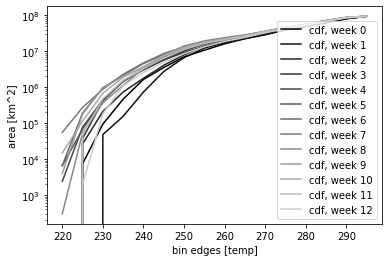

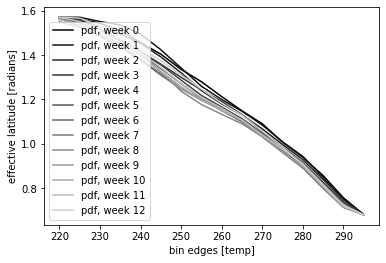

In [14]:
#now for realzies with all weeks
pdf_lat = np.zeros([len(weeks),len(Tbins)-1])
cdf_area = np.zeros([len(weeks),len(Tbins)-1])
colors = np.linspace(0,0.8,num=len(weeks),dtype=str)
for w in weeks:
    timestamp = times[w]
    this_week_temp = Temps[times==timestamp]
    x,pdf,cdf_area[w,:] = dists_of_areas(this_week_temp,lats[times==timestamp])
    pdf_lat[w,:],cdf = dists_of_lat_eff(cdf_area[w,:])
    plt.plot(x,cdf_area[w],label='cdf, week %i'%w,c=colors[w])
plt.legend()
plt.xlabel('bin edges [temp]')
plt.ylabel('area [km^2]')
plt.yscale('log')
plt.show()

for w in weeks:
    plt.plot(x,pdf_lat[w],label='pdf, week %i'%w,c=colors[w])
plt.legend()
plt.xlabel('bin edges [temp]')
plt.ylabel('effective latitude [radians]')
plt.show()

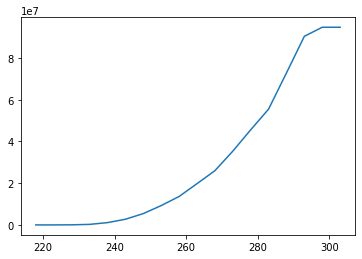

In [45]:
plt.plot(x,cdf_area[0])

plt.show()

In [44]:
# data_to_save = pd.DataFrame()
# left_temps = np.tile(x,(len(weeks),1))
#data_to_save['left_temp_interval']=left_temps
# data_to_save['cdf_area']=cdf_area
# data_to_save['pdf_lat']=pdf_lat
path_to_save = '/project2/geos39650/jet_stream/data/amanda/'
np.savetxt(path_to_save+'left_temp_interval.csv',x)
np.savetxt(path_to_save+'times.csv',times)
np.savetxt(path_to_save+'cdf_area.csv',cdf_area)
np.savetxt(path_to_save+'pdf_lat.csv',pdf_lat)